In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
sns.set()
%matplotlib inline
import matplotlib.pyplot as plt
import plotly.express as px

In [2]:
# load dataframe
df = pd.read_csv('WA_Fn-UseC_-HR-Employee-Attrition.csv')
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

In [4]:
for col in df.columns:
    print(f"{col}: Number of Unique values: {df[col].nunique()}")
    print("_____________________________")

Age: Number of Unique values: 43
_____________________________
Attrition: Number of Unique values: 2
_____________________________
BusinessTravel: Number of Unique values: 3
_____________________________
DailyRate: Number of Unique values: 886
_____________________________
Department: Number of Unique values: 3
_____________________________
DistanceFromHome: Number of Unique values: 29
_____________________________
Education: Number of Unique values: 5
_____________________________
EducationField: Number of Unique values: 6
_____________________________
EmployeeCount: Number of Unique values: 1
_____________________________
EmployeeNumber: Number of Unique values: 1470
_____________________________
EnvironmentSatisfaction: Number of Unique values: 4
_____________________________
Gender: Number of Unique values: 2
_____________________________
HourlyRate: Number of Unique values: 71
_____________________________
JobInvolvement: Number of Unique values: 4
_____________________________
Jo

In [5]:
for col in df.columns:
    if df[col].nunique() ==1:
        print(col)

EmployeeCount
Over18
StandardHours


In [6]:
for col in df.columns:
    if df[col].dtypes != object and df[col].nunique()<=10:
        print(f"{col} :MIN :{df[col].min()}, MAX : {df[col].max()}")
        print("___________________________")

Education :MIN :1, MAX : 5
___________________________
EmployeeCount :MIN :1, MAX : 1
___________________________
EnvironmentSatisfaction :MIN :1, MAX : 4
___________________________
JobInvolvement :MIN :1, MAX : 4
___________________________
JobLevel :MIN :1, MAX : 5
___________________________
JobSatisfaction :MIN :1, MAX : 4
___________________________
NumCompaniesWorked :MIN :0, MAX : 9
___________________________
PerformanceRating :MIN :3, MAX : 4
___________________________
RelationshipSatisfaction :MIN :1, MAX : 4
___________________________
StandardHours :MIN :80, MAX : 80
___________________________
StockOptionLevel :MIN :0, MAX : 3
___________________________
TrainingTimesLastYear :MIN :0, MAX : 6
___________________________
WorkLifeBalance :MIN :1, MAX : 4
___________________________


### show some describtive statistics about data

In [7]:
df.describe()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,...,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,2.063946,...,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,0.0,602.024335,1.093082,20.329428,0.711561,1.106940,...,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,1.000000,...,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,1.0,491.250000,2.000000,48.000000,2.000000,1.000000,...,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1.0,1020.500000,3.000000,66.000000,3.000000,2.000000,...,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1.0,1555.750000,4.000000,83.750000,3.000000,3.000000,...,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,5.000000,...,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


#### * preprecessing  Data
  * check null values
  * check duplicates
  * data fromates

In [8]:
# is there null values
df.isnull().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

In [9]:
# check duplicates
df.duplicated().sum()
# no duplicated value in data

0

In [10]:
df.dtypes

Age                          int64
Attrition                   object
BusinessTravel              object
DailyRate                    int64
Department                  object
DistanceFromHome             int64
Education                    int64
EducationField              object
EmployeeCount                int64
EmployeeNumber               int64
EnvironmentSatisfaction      int64
Gender                      object
HourlyRate                   int64
JobInvolvement               int64
JobLevel                     int64
JobRole                     object
JobSatisfaction              int64
MaritalStatus               object
MonthlyIncome                int64
MonthlyRate                  int64
NumCompaniesWorked           int64
Over18                      object
OverTime                    object
PercentSalaryHike            int64
PerformanceRating            int64
RelationshipSatisfaction     int64
StandardHours                int64
StockOptionLevel             int64
TotalWorkingYears   

### * Data Eploration

In [11]:
from pandas_profiling import ProfileReport
# used to create reprot file about data

C:\Users\esraa omaar\AppData\Local\Temp\ipykernel_22024\1628364619.py:1: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


In [12]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### how many attrition in data

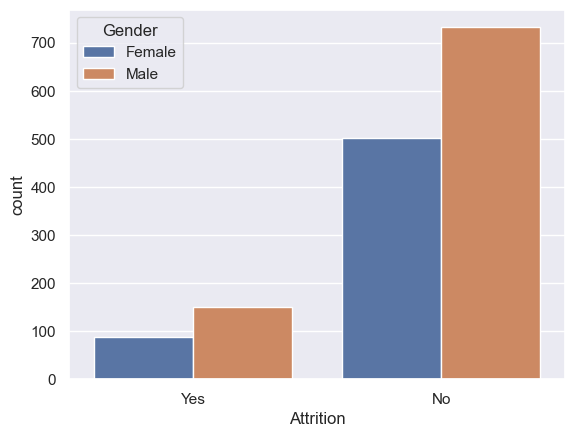

In [13]:
sns.countplot(data = df, x ='Attrition',hue ='Gender')
plt.show()

In [14]:
df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

#### What is effect of age on Attriation?

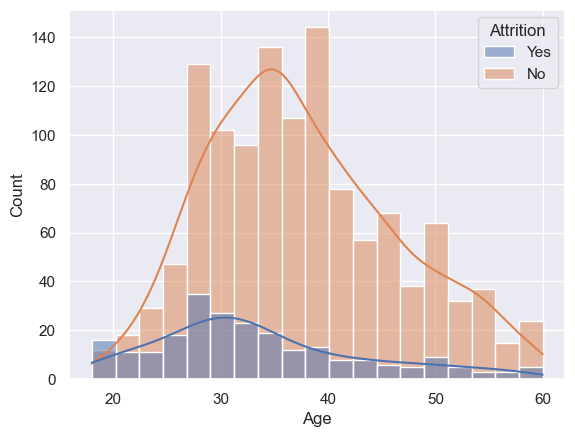

In [15]:
sns.histplot(data = df, x='Age',hue ='Attrition',kde = True)
plt.show()

#### 
* Most of the employees who leave the work are aroun the age from 25 --30


####  1- how many employees in each department ?
####  2- in which department has high attriation?



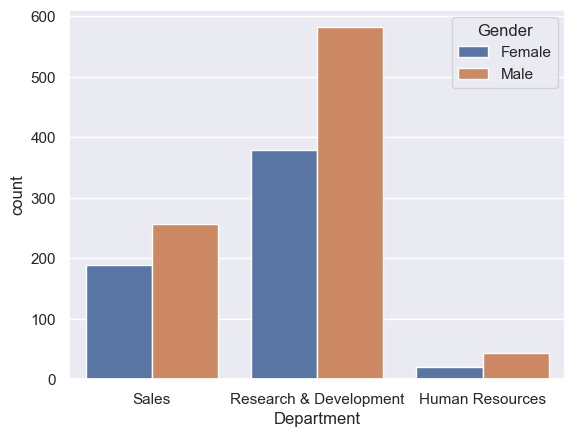

In [16]:
sns.countplot(data = df,x='Department', hue ='Gender')
plt.show()

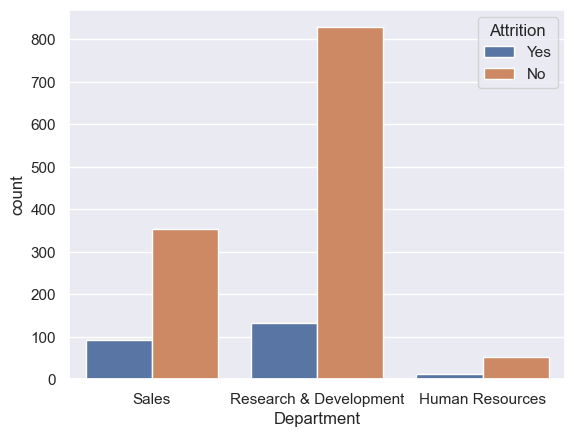

In [17]:
sns.countplot(data = df,x='Department', hue ='Attrition')
plt.show()

In [18]:
df['Attrition'].value_counts()

No     1233
Yes     237
Name: Attrition, dtype: int64

In [19]:
df.groupby('Department')['Attrition'].value_counts()

Department              Attrition
Human Resources         No            51
                        Yes           12
Research & Development  No           828
                        Yes          133
Sales                   No           354
                        Yes           92
Name: Attrition, dtype: int64

###  3- how distance from home  affect on the Attrition?

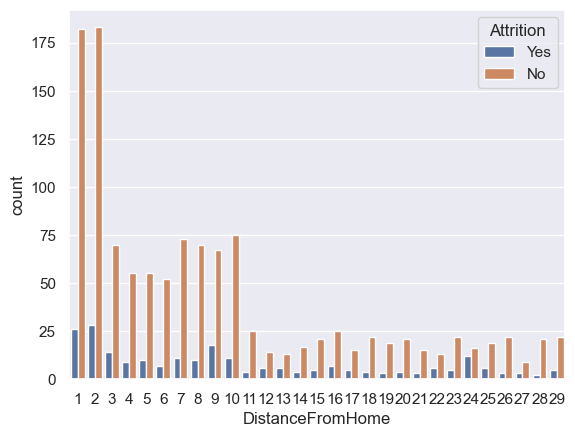

In [20]:
sns.countplot(data = df,x='DistanceFromHome',hue='Attrition')
plt.show()

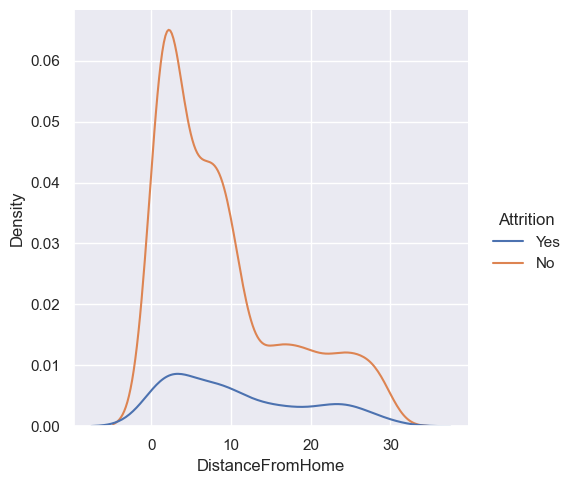

In [21]:
sns.displot(df,x ='DistanceFromHome',hue ='Attrition',kind='kde')
plt.show()


### 4- How eduction and Education field affect on the Attrition?

#### Education
* 1 'Below College'
* 2 'College'
* 3 'Bachelor'
* 4 'Master'
* 5 'Doctor'

<AxesSubplot:xlabel='Education', ylabel='count'>

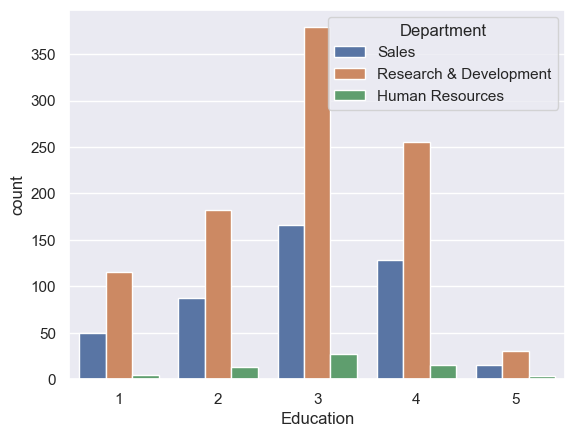

In [22]:
sns.countplot(data = df,x='Education',hue='Department')


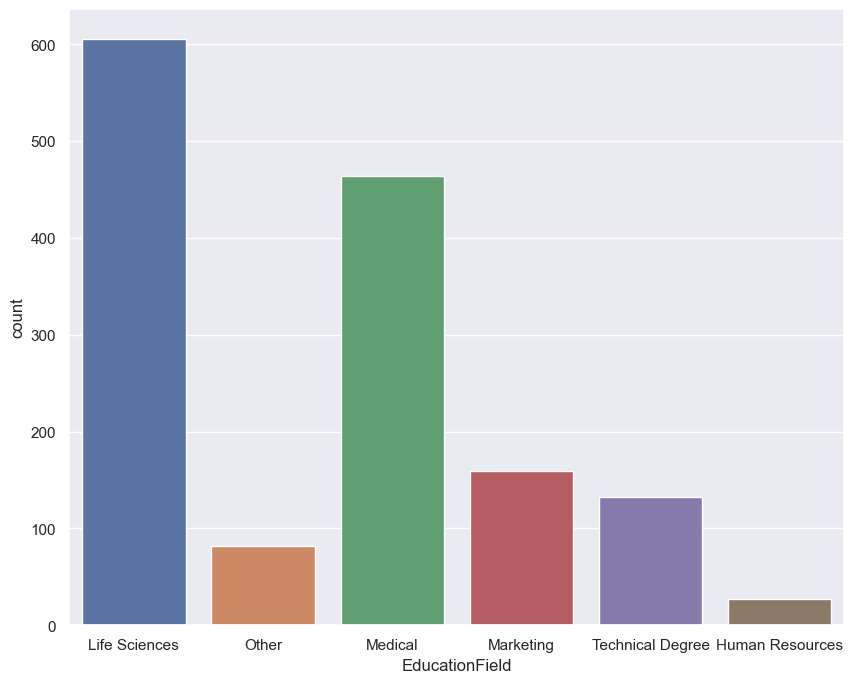

In [23]:
plt.figure(figsize=(10,8))
sns.countplot(data = df, x= 'EducationField')
plt.show()

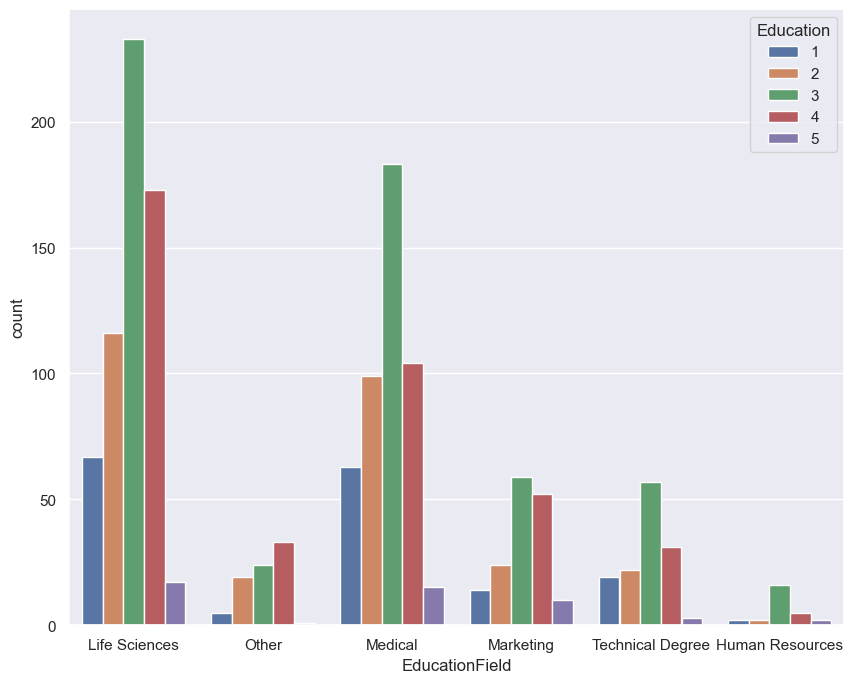

In [24]:
plt.figure(figsize=(10,8))
sns.countplot(data = df, x= 'EducationField',hue ='Education')
plt.show()

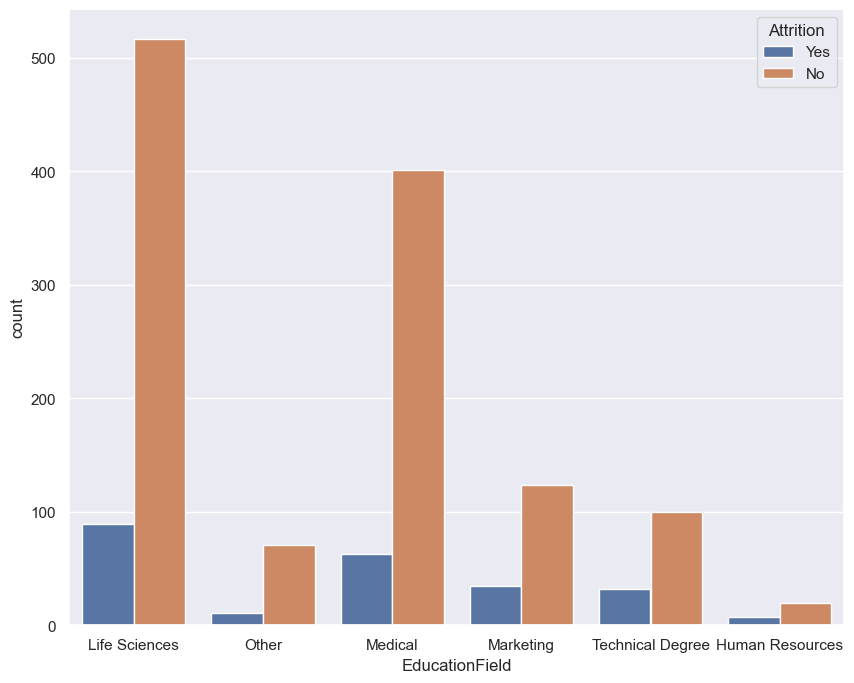

In [25]:
plt.figure(figsize =(10,8))
sns.countplot(data= df,x='EducationField',hue='Attrition')
plt.show()

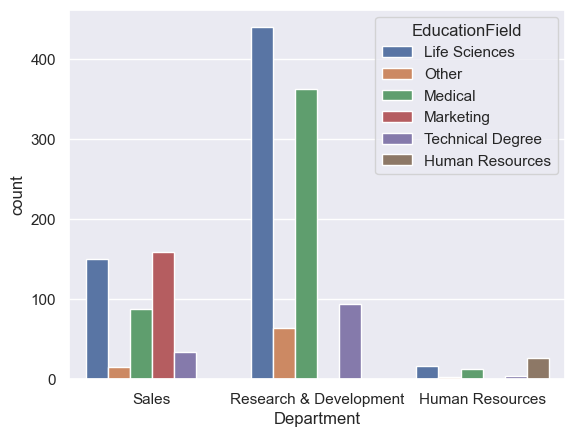

In [26]:
sns.countplot(data =df,x='Department',hue = 'EducationField')
plt.show()

### 5- How Environment Satisfaction affect on the Attrition?

#### EnvironmentSatisfaction
* 1 'Low'
* 2 'Medium'
* 3 'High'
* 4 'Very High'

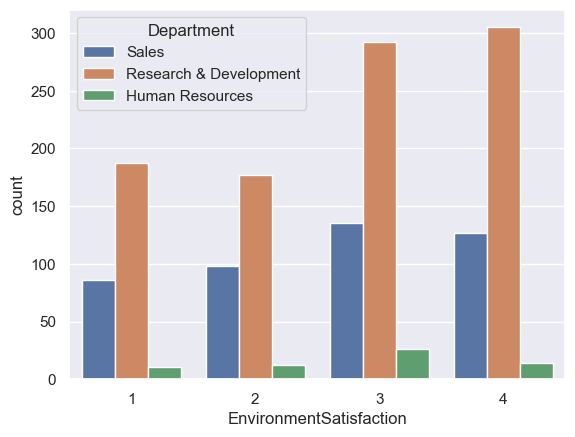

In [27]:
sns.countplot(data = df,x ='EnvironmentSatisfaction', hue = 'Department')
plt.show()

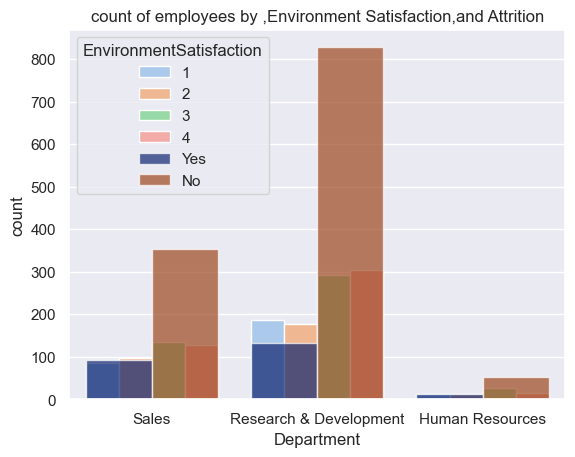

In [28]:
attrition_palette = sns.color_palette("dark")
environtmentS_palette=sns.color_palette("pastel")

sns.countplot(data = df,x='Department', hue ='EnvironmentSatisfaction',dodge= True,palette = environtmentS_palette)
sns.countplot(data = df, x='Department',hue='Attrition',dodge=True,palette=attrition_palette,alpha = 0.7)
plt.xlabel('Department')
plt.ylabel('count')
plt.title('count of employees by ,Environment Satisfaction,and Attrition')
plt.legend(title = 'EnvironmentSatisfaction')
plt.show()

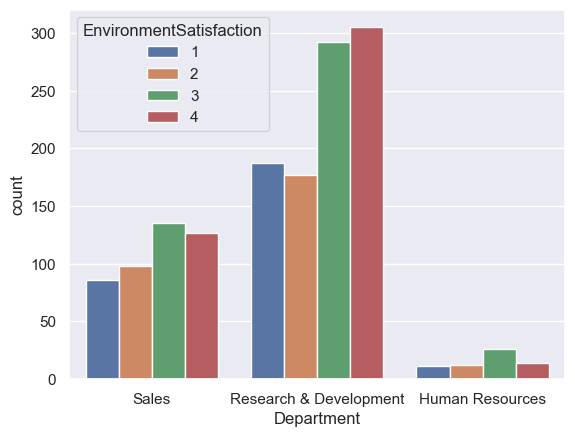

In [29]:
sns.countplot(data = df,x ='Department',hue = 'EnvironmentSatisfaction')
plt.show()

In [30]:
 sns.color_palette("pastel")

[(0.6313725490196078, 0.788235294117647, 0.9568627450980393),
 (1.0, 0.7058823529411765, 0.5098039215686274),
 (0.5529411764705883, 0.8980392156862745, 0.6313725490196078),
 (1.0, 0.6235294117647059, 0.6078431372549019),
 (0.8156862745098039, 0.7333333333333333, 1.0),
 (0.8705882352941177, 0.7333333333333333, 0.6078431372549019),
 (0.9803921568627451, 0.6901960784313725, 0.8941176470588236),
 (0.8117647058823529, 0.8117647058823529, 0.8117647058823529),
 (1.0, 0.996078431372549, 0.6392156862745098),
 (0.7254901960784313, 0.9490196078431372, 0.9411764705882353)]

In [31]:
# import plotly.io as pio
# pio.renderers.default = 'notebook_connected'


In [32]:
# satisfaction_labels={
#     1: 'Low',
#     2: 'Medium',
#     3: 'High',
#     4: 'Very High'    
# }
# df['EnvironmentSatisfaction']= df['EnvironmentSatisfaction'].map(satisfaction_labels)
# attrition_env = pd.DataFrame(df.groupby('EnvironmentSatisfaction')['Attrition'].value_counts())
# attrition_env = attrition_env.rename(columns ={'Attrition':'count'})
# attrition_env = attrition_env.reset_index()
# # creat a sunburts
# fig_sunburst = px.sunburst(attrition_env,path =['EnvironmentSatisfaction', 'Attrition'],values ='count',title ='Attrition distribution by Environment Satisfaction')
# # update trace properties to show labels with percentage of patent
# fig_sunburst.update_traces(textinfo ="label+percent parent")
# # show sunburst chart
# fig_sunburst.show() 

In [33]:
attrition_env = pd.DataFrame(df.groupby('EnvironmentSatisfaction')['Attrition'].value_counts())
attrition_env = attrition_env.rename(columns ={'Attrition':'count'})
attrition_env = attrition_env.reset_index()
attrition_env

,EnvironmentSatisfaction,Attrition,count
0,1,No,212
1,1,Yes,72
2,2,No,244
3,2,Yes,43
4,3,No,391
5,3,Yes,62
6,4,No,386
7,4,Yes,60


In [34]:
import plotly
print(plotly.__version__)

5.16.1


In [35]:
# satisfaction_labels={
#     1: 'Low',
#     2: 'Medium',
#     3: 'High',
#     4: 'Very High'    
# }
# df['EnvironmentSatisfaction']= df['EnvironmentSatisfaction'].map(satisfaction_labels)
# attrition_env = pd.DataFrame(df.groupby('EnvironmentSatisfaction')['Attrition'].value_counts())
# attrition_env = attrition_env.rename(columns ={'Attrition':'count'})
# attrition_env = attrition_env.reset_index()
# # creat a sunburts
# fig_sunburst = px.sunburst(attrition_env,path =['EnvironmentSatisfaction', 'Attrition'],values ='count',title ='Attrition distribution by Environment Satisfaction')
# # update trace properties to show labels with percentage of patent
# fig_sunburst.update_traces(textinfo ="label+percent parent")
# # show sunburst chart
# fig_sunburst.show() 

### How the gender affect on the Attrition?


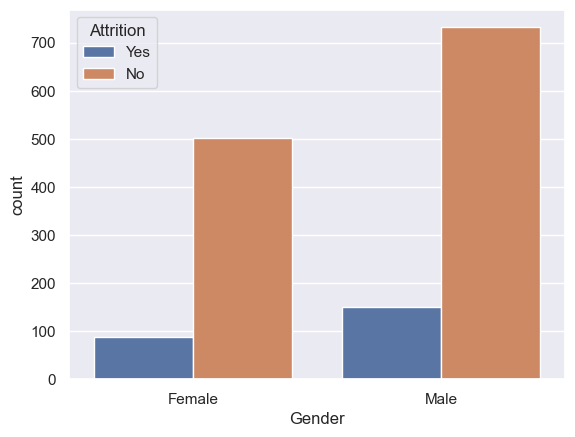

In [36]:
sns.countplot(data =df, x ='Gender',hue = 'Attrition')
plt.show()

###  1- how the job staisfaction affect on the attrition?
### 2 - what is the most job role of attrition?


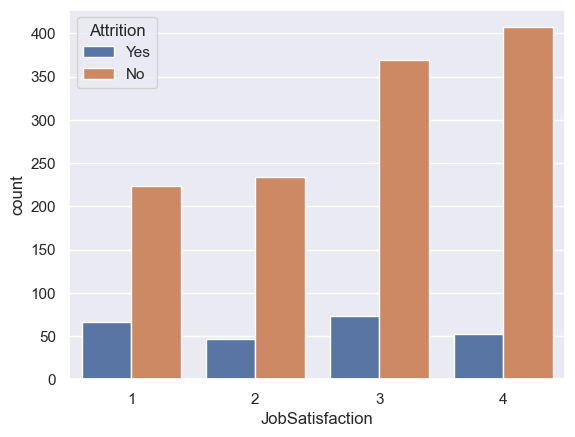

In [37]:
sns.countplot(data =df , x='JobSatisfaction' , hue = 'Attrition')
plt.show()

In [38]:
# att_p =sns.color_palette("dark")
# job_p = sns.color_palette("pastel")
# sns.countplot(data = df, x ='Department' ,hue = 'JobRole',dodge = True ,palette = job_p)
# sns.countplot(data = df ,x='Department',hue ='Attrition',dodge=True,palette = att_p)
# plt.xlabel('Department')
# plt.ylabel('count')
# plt.title('Count of Employees ,JobRole, and Attrition')
# plt.show()

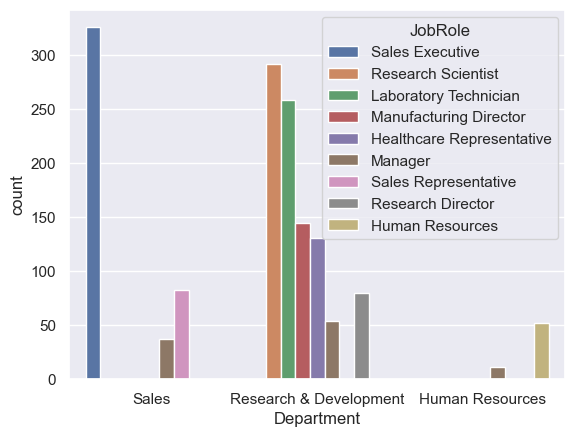

In [39]:
sns.countplot(data = df, x='Department',hue ='JobRole')
plt.show()

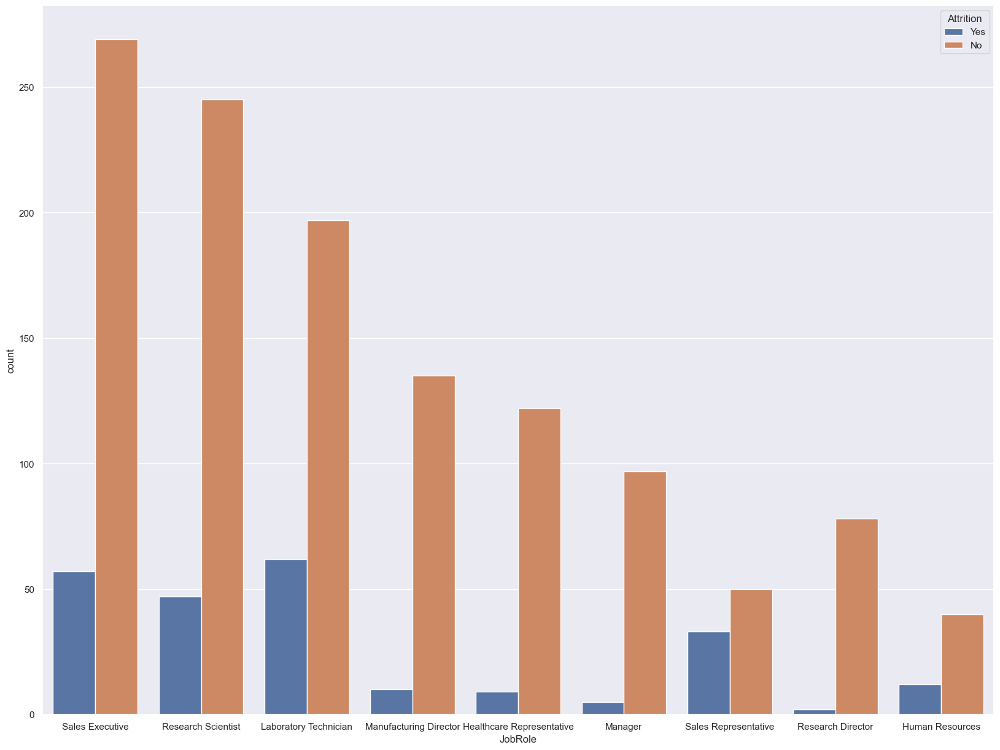

In [40]:
plt.figure(figsize =(20,15))
sns.countplot(data = df,x='JobRole', hue ='Attrition')
plt.show()

In [41]:
dff = pd.DataFrame(df.groupby('JobRole')['Attrition'].value_counts())
dff = dff.rename(columns={'Attrition':'Count'})
# dff = dff.reset_index()
dff

Count
JobRole                   Attrition       
Healthcare Representative No           122
                          Yes            9
Human Resources           No            40
                          Yes           12
Laboratory Technician     No           197
                          Yes           62
Manager                   No            97
                          Yes            5
Manufacturing Director    No           135
                          Yes           10
Research Director         No            78
                          Yes            2
Research Scientist        No           245
                          Yes           47
Sales Executive           No           269
                          Yes           57
Sales Representative      No            50
                          Yes           33

In [42]:
px.histogram(data_frame = df, x='JobRole',color ='Attrition')

In [43]:
df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

In [44]:
# plt.figure(figsize =(30,30))
# sns.heatmap(df.corr(),annot= True)
# plt.show()

In [45]:
### complete exploring the data

In [46]:
df['EnvironmentSatisfaction']

0       2
1       3
2       4
3       4
4       1
       ..
1465    3
1466    4
1467    2
1468    4
1469    2
Name: EnvironmentSatisfaction, Length: 1470, dtype: int64

# Drop unnessary columns

In [47]:
# drop columns that have one values
x= df.drop('Attrition',axis =1)
y = df['Attrition']

## Label encoding for Target

In [48]:
from sklearn.preprocessing import LabelEncoder

In [49]:
encoder = LabelEncoder()
y = encoder.fit_transform(y)
y

array([1, 0, 1, ..., 0, 0, 0])

## Encoding Categorical columns

In [50]:
x = pd.get_dummies(x,drop_first = True)
x.head()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Married,MaritalStatus_Single,OverTime_Yes
0,41,1102,1,2,1,1,2,94,3,2,...,0,0,0,0,0,1,0,0,1,1
1,49,279,8,1,1,2,3,61,2,2,...,0,0,0,0,1,0,0,1,0,0
2,37,1373,2,2,1,4,4,92,2,1,...,1,0,0,0,0,0,0,0,1,1
3,33,1392,3,4,1,5,4,56,3,1,...,0,0,0,0,1,0,0,1,0,1
4,27,591,2,1,1,7,1,40,3,1,...,1,0,0,0,0,0,0,1,0,0


## Split data

In [51]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size =0.3,random_state = 101,stratify = y)

In [52]:
x_train.shape , y_train.shape

((1029, 47), (1029,))

In [53]:
x.shape , y.shape

((1470, 47), (1470,))

In [54]:
x_train

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Married,MaritalStatus_Single,OverTime_Yes
1447,36,301,15,4,1,2036,4,88,1,2,...,0,0,0,0,0,1,0,0,0,0
1010,55,1136,1,4,1,1424,2,81,4,4,...,0,0,0,1,0,0,0,0,0,0
816,39,439,9,3,1,1132,3,70,3,2,...,1,0,0,0,0,0,0,0,1,0
241,32,976,26,4,1,333,3,100,3,2,...,0,0,0,0,0,1,0,1,0,0
863,33,147,2,3,1,1207,2,99,3,1,...,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
208,40,1151,9,5,1,287,4,63,2,2,...,0,0,0,0,0,0,0,1,0,0
102,20,871,6,3,1,137,4,66,2,1,...,1,0,0,0,0,0,0,0,1,1
1037,45,1448,29,3,1,1465,2,55,3,3,...,0,0,1,0,0,0,0,1,0,1
1009,58,1055,1,3,1,1423,4,76,3,5,...,0,0,0,1,0,0,0,1,0,1


In [55]:
y_train

array([0, 0, 0, ..., 0, 0, 0])

In [56]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x_train = pd.DataFrame(scaler.fit_transform(x_train), columns = x_train.columns)
x_test = pd.DataFrame(scaler.transform(x_test), columns = x_test.columns)
x_train.head()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Married,MaritalStatus_Single,OverTime_Yes
0,-0.106657,-1.208140,0.720187,1.045784,0.0,1.696421,1.181744,1.092990,-2.473813,-0.059696,...,-0.468182,-0.282397,-0.331711,-0.228358,-0.513934,1.879638,-0.23763,-0.899131,-0.693236,-0.621926
1,1.968221,0.849952,-1.041276,1.045784,0.0,0.679338,-0.646849,0.748085,1.775859,1.720788,...,-0.468182,-0.282397,-0.331711,4.379095,-0.513934,-0.532017,-0.23763,-0.899131,-0.693236,-0.621926
2,0.220955,-0.868001,-0.034726,0.066610,0.0,0.194063,0.267447,0.206091,0.359302,-0.059696,...,2.135922,-0.282397,-0.331711,-0.228358,-0.513934,-0.532017,-0.23763,-0.899131,1.442511,-0.621926
3,-0.543473,0.455587,2.104194,1.045784,0.0,-1.133796,0.267447,1.684256,0.359302,-0.059696,...,-0.468182,-0.282397,-0.331711,-0.228358,-0.513934,1.879638,-0.23763,1.112185,-0.693236,-0.621926
4,-0.434269,-1.587717,-0.915457,0.066610,0.0,0.318705,-0.646849,1.634984,0.359302,-0.949937,...,-0.468182,-0.282397,-0.331711,-0.228358,-0.513934,-0.532017,-0.23763,1.112185,-0.693236,-0.621926


In [57]:
x_test.head()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Married,MaritalStatus_Single,OverTime_Yes
0,0.002547,1.084106,1.475100,-0.912563,0.0,-0.191498,0.267447,-0.582264,0.359302,-0.949937,...,-0.468182,-0.282397,-0.331711,-0.228358,-0.513934,-0.532017,4.208217,1.112185,-0.693236,-0.621926
1,0.548568,-1.240182,-0.915457,0.066610,0.0,0.883752,1.181744,-1.272075,0.359302,0.830546,...,-0.468182,-0.282397,-0.331711,-0.228358,-0.513934,-0.532017,-0.237630,1.112185,-0.693236,1.607907
2,-0.761882,0.527066,-0.789638,0.066610,0.0,-1.193624,1.181744,1.092990,0.359302,-0.949937,...,-0.468182,-0.282397,-0.331711,-0.228358,1.945777,-0.532017,-0.237630,-0.899131,1.442511,1.607907
3,0.548568,1.182697,-0.915457,-1.891737,0.0,-0.233046,-0.646849,-1.518435,0.359302,-0.949937,...,-0.468182,-0.282397,-0.331711,-0.228358,1.945777,-0.532017,-0.237630,-0.899131,1.442511,1.607907
4,-0.761882,0.854881,-0.412182,0.066610,0.0,0.491543,-1.561146,-0.877897,-1.057256,-0.059696,...,2.135922,-0.282397,-0.331711,-0.228358,-0.513934,-0.532017,-0.237630,1.112185,-0.693236,-0.621926


# Logistic Regression

In [58]:
from sklearn.linear_model import LogisticRegression
log_r = LogisticRegression()
log_r.fit(x_train,y_train)
y_pred = log_r.predict(x_test)


In [59]:
y_test_label = encoder.inverse_transform(y_test)
y_pred_label = encoder.inverse_transform(y_pred)
df_res = pd.DataFrame({'Actual': y_test_label,'predict': y_pred_label})
df_res

,Actual,predict
0,No,No
1,No,No
2,Yes,No
3,No,Yes
4,No,No
...,...,...
436,Yes,Yes
437,Yes,Yes
438,No,No
439,No,No


## evaluate the classification model:
* Accuracy
* precision / recall / f1 score   (classification_report)
* ROC Curve and AUC (hiegher AUC indicates better preformance)
* confusion matrix

In [60]:
from sklearn.metrics import confusion_matrix ,accuracy_score,classification_report

In [61]:
cm = confusion_matrix(y_test,y_pred)
cm

array([[350,  20],
       [ 34,  37]], dtype=int64)

<AxesSubplot:>

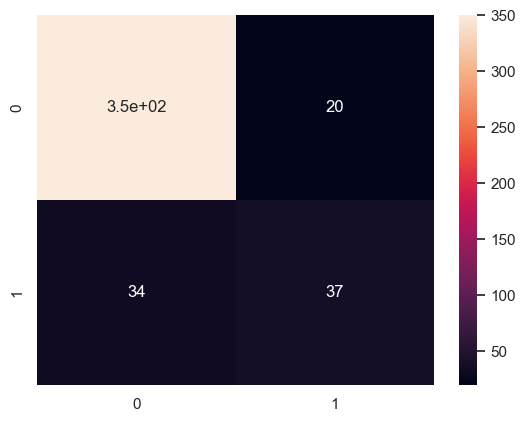

In [62]:
sns.heatmap(cm,annot = True)

In [63]:
# accuracy of the model
accuracy = accuracy_score(y_test,y_pred)
print('Accuracy: %.2f%%' %(accuracy *100.0))

Accuracy: 87.76%


In [64]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.91      0.95      0.93       370
           1       0.65      0.52      0.58        71

    accuracy                           0.88       441
   macro avg       0.78      0.73      0.75       441
weighted avg       0.87      0.88      0.87       441



* the logistic model preforms ralativly well in class 0(Attrition = No)
* it performs less satisfactorily for class 1 (Attrition = yes)
* the accuracy of the model is 87.76 % ,indicating the overall correctness of the predictions

# Naive base Algorithim:

## split data in train and validation

In [65]:
# you split the data totrain and test in prev
# x_trian,x_test,y_train,y_test = train_test_split(x,y,test_size= 0.2, random_state= 42,stratify =y)


In [66]:
x_train.shape , y_train.shape

((1029, 47), (1029,))

In [67]:
# split to validation
x_train,x_val,y_train,y_val = train_test_split(x_train,y_train,test_size =0.2,random_state = 42)

In [68]:
x_val.shape , y_val.shape,x_train.shape

((206, 47), (206,), (823, 47))

# Naive Bayes

In [69]:
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import recall_score, precision_score

In [70]:
classifier = GaussianNB()

In [71]:
# fit the training data
classifier.fit(x_train,y_train)

GaussianNB()

### apply the model on validation data

In [72]:
train_pred = classifier.predict(x_train)
y_pred_val = classifier.predict(x_val)
# accuracy of train
train_accuracy = accuracy_score(train_pred , y_train)
train_recall = recall_score(train_pred , y_train)
train_precision = precision_score(train_pred, y_train)

# accuracy of the validation prediction
val_accuracy = accuracy_score(y_pred_val , y_val)
val_recall = recall_score(y_pred_val , y_val)
val_precision = precision_score(y_pred_val , y_val)

print('Accuracy Train: % .2f , Validiation: %.2f'%(train_accuracy , val_accuracy))
print('Recall Train : % .2f , Validiation: %.2f'%(train_recall,val_recall))
print('Precision Train: % .2f , Validiation: %.2f'%(train_precision , val_precision))

Accuracy Train:  0.70 , Validiation: 0.68
Recall Train :  0.33 , Validiation: 0.24
Precision Train:  0.74 , Validiation: 0.87


In [73]:
confusion_matrix (y_train,train_pred)

array([[466, 214],
       [ 37, 106]], dtype=int64)

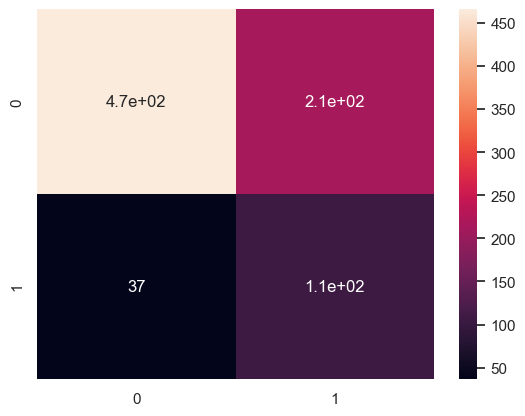

In [74]:
# confusion matric for train
sns.heatmap(confusion_matrix (y_train,train_pred),annot = True)
plt.show()

In [75]:
# confusion_matrix for validiation data
cm = confusion_matrix (y_val,y_pred_val)
cm

array([[121,  62],
       [  3,  20]], dtype=int64)

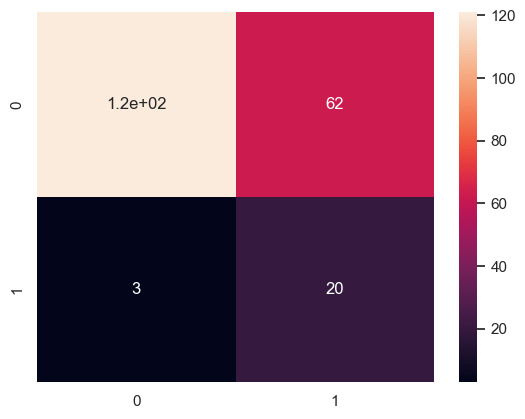

In [76]:
sns.heatmap(cm , annot=True)
plt.show()

## Apply the model on the test data

In [77]:
y_pred = classifier.predict(x_test)
# accuracy for testing
test_accuracy = accuracy_score(y_test,y_pred)
print('Test Accuracy :% .2f'%(test_accuracy))
# calssification reprot for testing
test_classification_report = classification_report(y_test,y_pred)
print('Classification Report : ')
print(test_classification_report)
# confusion_matrix for testing
cm = confusion_matrix(y_test , y_pred)
print('Confusion matrix: ',cm)

Test Accuracy : 0.63
Classification Report : 
              precision    recall  f1-score   support

           0       0.93      0.60      0.73       370
           1       0.27      0.76      0.40        71

    accuracy                           0.63       441
   macro avg       0.60      0.68      0.56       441
weighted avg       0.82      0.63      0.68       441

Confusion matrix:  [[223 147]
 [ 17  54]]


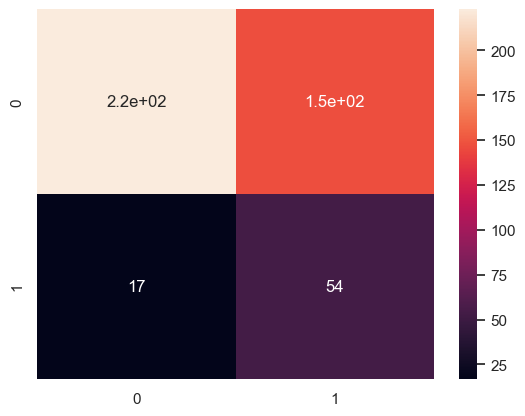

In [78]:
sns.heatmap(cm,annot = True)
plt.show()

# Random Forest Algorithm

In [80]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


In [81]:
from sklearn.preprocessing import LabelEncoder
# encode categorical variable with ordinal encoding
encoder = LabelEncoder()
df = df.apply(encoder.fit_transform)
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,23,1,2,624,2,0,1,1,0,0,...,0,0,0,8,0,0,6,4,0,5
1,31,0,1,113,1,7,0,1,0,1,...,3,0,1,10,3,2,10,7,1,7
2,19,1,2,805,1,1,1,4,0,2,...,1,0,0,7,3,2,0,0,0,0
3,15,0,1,820,1,2,3,1,0,3,...,2,0,0,8,3,2,8,7,3,0
4,9,0,2,312,1,1,0,3,0,4,...,3,0,1,6,3,2,2,2,2,2


In [82]:
# split the data to feature ,target
x = df.drop('Attrition',axis = 1)
y = df['Attrition']

In [83]:
x.shape , y.shape

((1470, 34), (1470,))

In [86]:
# split data into training and test set
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size =0.3,random_state = 42,stratify =y)

In [87]:
x_train.shape, y_train.shape , x_test.shape , y_test.shape

((1029, 34), (1029,), (441, 34), (441,))

# Random Forest Classifier model with default parameters

In [96]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators =10)
# fit the model
rfc.fit(x_train ,y_train)
# predict the model
y_pred = rfc.predict(x_test)

# check accuracy score
print('Model accracy score :{0:0.4f}'.format(accuracy_score(y_test,y_pred)))
 

Model accracy score :0.8322


# RFC with n_estimator = 100

In [98]:
rfc_100  = RandomForestClassifier(n_estimators =100)
# fit the model
rfc_100.fit(x_train,y_train)
# predict the model 
y_pred_100 = rfc_100.predict(x_test)
# check accuracy score
print('model accuracy score with 100 decision Tree :{0:0.4f}'.format(accuracy_score(y_test,y_pred)))

model accuracy score with 100 decision Tree :0.8322


# Find important Features with RF

In [100]:
clf = RandomForestClassifier(n_estimators = 100, random_state =0)
# fit the model to the training set
clf.fit(x_train,y_train)

RandomForestClassifier(random_state=0)

#### use the feature importance variable to see feature importance scores

In [103]:
# view the feature score
feature_scores = pd.Series(clf.feature_importances_, index = x_train.columns).sort_values(ascending = False)
feature_scores

MonthlyIncome               0.079069
TotalWorkingYears           0.060583
Age                         0.056025
DailyRate                   0.051976
EmployeeNumber              0.049915
HourlyRate                  0.049195
MonthlyRate                 0.045129
YearsWithCurrManager        0.041415
DistanceFromHome            0.041233
YearsAtCompany              0.039850
NumCompaniesWorked          0.037307
OverTime                    0.035861
StockOptionLevel            0.031637
PercentSalaryHike           0.031383
JobRole                     0.030411
WorkLifeBalance             0.028147
JobInvolvement              0.027111
YearsInCurrentRole          0.026883
EnvironmentSatisfaction     0.025280
TrainingTimesLastYear       0.024753
RelationshipSatisfaction    0.024616
JobSatisfaction             0.024141
YearsSinceLastPromotion     0.022594
Education                   0.020678
EducationField              0.020192
JobLevel                    0.019004
MaritalStatus               0.017642
B

## visuallize feature scores of the features

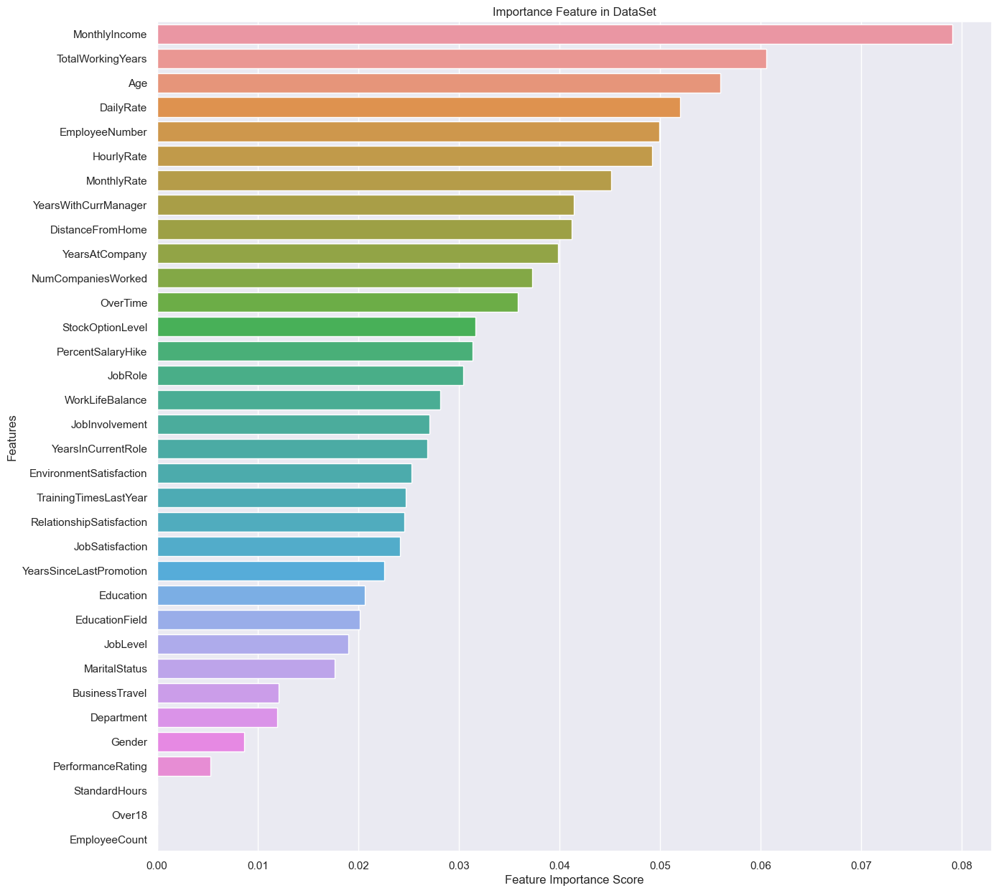

In [105]:
plt.figure(figsize = (15,15))
sns.barplot(x = feature_scores , y = feature_scores.index)
plt.xlabel('Feature Importance Score')
plt.ylabel('Features')
plt.title('Importance Feature in DataSet')
plt.show()

## build RF model on selected futures

In [119]:
x =df.loc[:, ['MonthlyIncome', 'TotalWorkingYears', 'Age', 'DailyRate', 'HourlyRate', 'MonthlyRate']]
# x =np.array(df.loc[:, ['MonthlyIncome', 'TotalWorkingYears', 'Age', 'DailyRate', 'HourlyRate', 'MonthlyRate']]).reshape(-1,1) 
y = df['Attrition']
# y= np.array(df['Attrition']).reshape(-1,1)

In [120]:
# split data into training and testing sets
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size = 0.33,random_state = 42,stratify = y)

In [121]:
x_train.shape , y_train.shape , x_test.shape ,y_test.shape

((984, 6), (984,), (486, 6), (486,))

In [129]:
clf = RandomForestClassifier()
# fit the model
clf.fit(x_train,y_train)
# predict the model
y_pred = clf.predict(x_test)
# y_pred_reshaped = y_pred.reshape(1,-1)
# check accuracy score
print('model accuracy score with feature selection {0:0.4f}'.format(accuracy_score(y_test,y_pred)))

model accuracy score with feature selection 0.8189


In [128]:
y_test.shape , y_pred.shape

((486,), (441,))